<a href="https://colab.research.google.com/github/rishabh135/2015/blob/master/SAM_2_on_Sieve.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>



<img src="https://drive.google.com/thumbnail?id=1cOBLYn6c0u8PLH5gCgotvhtJi4d1o3dS&sz=w1000" alt="drawing" width="600"/>

# Segment Anything 2 on Sieve
We recently launched an optimized verison of SAM 2 on Sieve! This notebook will show you how to get started and walk through all the different cool features.


## Table of Contents
[Introduction to SAM 22](#scrollTo=UnB5ZrypwqH9)

[Introduction to Sieve](#scrollTo=xzJm167OwqH-)

[Getting Started](#scrollTo=JUQd9zDrwqH_)

[Processing Videos](#scrollTo=7OYvqNZGwqIB)

>[Prompting](#scrollTo=7OYvqNZGwqIB)

>[Model Types](#scrollTo=UT3PBmybwqIC)

>[Segmentation Output](#scrollTo=UT3PBmybwqIC)

>[Bounding Box Tracking](#scrollTo=2-MajP1iwqID)

>[Pixel Confidences](#scrollTo=9hsWXArhwqID)

>[Debug Video](#scrollTo=v3FWDBIowqID)

>[Trimming](#scrollTo=ep5gn7LhwqID)

>[Previewing](#scrollTo=_r4wrIjZwqID)

[Processing Images](#scrollTo=ipkG6H1PwqIE)

>[Image Multimask](#scrollTo=qxwaPofBwqIE)



## Introduction to SAM 2

SAM 2 (Segment Anything 2) is a new foundation model released by the FAIR team at Meta for video and image segmentation. It is the successor to the original Segment Anything Model (SAM), an image segmentation model released by Meta in 2023. SAM 2 introduces the capability to segment and track objects throughout a video sequence with as little as a single image prompt. See the official announcement [here](https://ai.meta.com/sam2/).


A "prompt" in the context of SAM 2 is simply a labeling of a region of interest in an image. This region of interest can be annotated with a bounding box or a point with a positive or negative label. If we'd like to segment the soccer ball in the following image, we could place a positive point on the ball, and negative points on background objects (like the arm of the person holding it).

<img src="https://drive.google.com/thumbnail?id=1pvZ3q5ztOElsaAwao10N_ECWPxwnjpsu&sz=w1000" alt="drawing" width="400"/>

This visualization was generated using Meta's [SAM 2 demo page](https://sam2.metademolab.com/demo). It's a great tool to use to understand how SAM 2 works!

The great thing about SAM 2 is that it works on videos! With this prompt for a single frame, we can track the soccer ball throughout the video:

<img src="https://drive.google.com/thumbnail?id=1fTN1jPsSj-zzasFDFg3DeOiGBgvox18Y&sz=w1000" alt="drawing" width="600">

When it is more convenient, we can also use a bounding box to label a region of interest. The SAM 2 demo page doesn't support bounding box prompts, but we'll show you how to use these later using Sieve's SAM 2 endpoint.

<img src="https://drive.google.com/thumbnail?id=1RqCF6bFypehHc1hI9g_rnX4Qw4ft97bm&sz=w1000" alt="drawing" width="400"/>

## Introduction to Sieve

Sieve is an AI platform that provides a suite of video-focused models and AI-powered capabilities that can be run at scale. The Sieve SDK allows you to build with and chain together these models and capabilites to easily create awesome AI-powered applications. To see all the amazing models and workflows that Sieve has to offer, check out our [explore page](https://www.sievedata.com/explore).

To use the Sieve SDK, you'll need to create an account and an API key. You can do this by going to [sievedata.com](https://www.sievedata.com) and clicking "Sign Up". Once you're signed up, you'll be able to access your API key on the [Settings page](https://www.sievedata.com/dashboard/settings). We provide all new users with $20 in free credits to get started 😀.

You'll need to add your API key as an environment variable:



In [ ]:
import os
os.environ['SIEVE_API_KEY'] = "put-your-api-key-here"

Then, you can install the Sieve SDK using pip:

In [ ]:
! pip install sievedata
! pip install ipympl
! pip install ipywidgets

try:
    from google.colab import output
    output.enable_custom_widget_manager()
except:
    pass

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 57.3/57.3 kB 912.3 kB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 257.9/257.9 kB 2.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.4/5.4 MB 28.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.5/78.5 kB 5.1 MB/s eta 0:00:00
  Created wheel for sseclient: filename=sseclient-0.0.27-py3-none-any.whl size=5564 sha256=36b60ab6686ccd0184fc2f8005413f47e64cba454cf8f53d9d8fb08dcd28f626
  Stored in directory: /root/.cache/pip/wheels/60/57/0e/09b1264923280e935a34cc543b7f147f5df12490bd7a992f42
Successfully built sseclient
  Attempting uninstall: tqdm
    Found existing installation: tqdm 4.66.5
    Uninstalling tqdm-4.66.5:
      Successfully uninstalled tqdm-4.66.5
  Attempting uninstall: grpcio
    Found existing installation: grpcio 1.64.1
    Uninstalling grpcio-1.64.1:
      Successfully uninstalled grpcio-1.64.1
  Using cached jedi-0.19.1-py2.py3-none-any.whl.

**Note:** For deeper insight into using Sieve, be sure to check out the [Sieve docs](https://docs.sievedata.com/guide/intro)!

## Getting Started

Sieve functions can be accessed with `sieve.function.get("function_name")`.

To use SAM 2, we'll need to get the `sieve/sam2` function.

In [ ]:
import sieve

sam2 = sieve.function.get("sieve/sam2")

ModuleNotFoundError: No module named 'sieve'

In addition to running sieve functions with the python SDK, you can also run them through our user interface. Check out https://www.sievedata.com/functions/sieve/sam2 and give it a try there! 😀

Sieve functions can be run both synchronously and asynchronously.

Using `fn.run()` will block until the function has finished processing and return the result.

(We'll explain the SAM 2 prompts in more detail in the next section)

In [ ]:
prompt = [{ # more info on prompts below
    "frame_index": 0,
    "object_id": 1,
    "points": [[300,200]],
    "labels": [1],
}]


hamster_video_url = "https://storage.googleapis.com/sieve-prod-us-central1-public-file-upload-bucket/c4811140-5f42-42e4-b612-1815effc2cfc/14aa4d0e-bb4c-42a3-a6c8-ea1f7ba56ea9-output-d966ffbf-d6b8-4ac3-9384-d7a49e90b4c1.mp4"

# try it with your own video url!
video_file = sieve.File(url=hamster_video_url)
# you can also upload a local file with
# video_file = sieve.File(path=/path/to/your/video.mp4)

debug_video, outputs = sam2.run(
    file=video_file,
    prompts=prompt,
    model_type="tiny",
    pixel_confidences=True,
    debug_masks=True,
    bbox_tracking=True
)

# render the video
import moviepy.editor
os.system(f"mv {debug_video.path} ./hamster_debug_output.mp4")
moviepy.editor.ipython_display("./hamster_debug_output.mp4")

FPS: 30.0

Extracted frames from video

Initializing model state...

Model state initialized.

Loading prompts...

Prompts loaded.

Propogating masks to video.

Number of frames in video: 489

We can use `fn.push()` to run the function asynchronously:

In [ ]:
# returns immediately
async_outputs = sam2.push(
    file=video_file,
    prompts=prompt,
    model_type="tiny"
)

# do other stuff
print("Doing other stuff...")

# now get the results!
print("Waiting for results...")
async_debug_video, async_outputs = async_outputs.result()

# render the video
os.system(f"mv {async_debug_video.path} ./hamster_debug_output_async.mp4")
moviepy.editor.ipython_display("./hamster_debug_output_async.mp4")


<SIEVE_INTERNAL> sieve struct sieve.File(url='https://storage.googleapis.com/sieve-prod-us-central1-public-file-upload-bucket/c4811140-5f42-42e4-b612-1815effc2cfc/14aa4d0e-bb4c-42a3-a6c8-ea1f7ba56ea9-output-d966ffbf-d6b8-4ac3-9384-d7a49e90b4c1.mp4') already has attribute _internal, not creating </SIEVE_INTERNAL>
Doing other stuff...
Waiting for results...


## Processing Videos

Next let's go into more detail on how to use SAM 2 to segment videos.

### Prompting

As mentioned above, a frame in SAM 2 can be prompted with points and bounding boxes. It's important to note that SAM 2 can handle multiple prompts across different frames.
This is useful in scenarios where a new object enters the frame, or for scene cuts.

```python
example_prompts = [
    { # Point-Label Prompt
        "frame_index": 0, # the index of the frame to apply the prompt to
        "object_id": 1, # the id of the object to track
        "points": [[300,200], [200, 300]], # 2d array of x,y points corresponding to labels
        "labels": [1, 0], # labels for each point (1 for positive, 0 for negative)
    },
    { # Bounding Box Prompt
        "frame_index": 50, # the index of the frame to apply the prompt to
        "object_id": 1, # the id of the object to track
        "box": [200, 200, 300, 400], # xmin, ymin, xmax, ymax
    }
    # ... you can add as many prompts as you want!
]
```
Another important note is that SAM 2 can track multiple objects at once. Just make sure to give each one a unique `object_id`.
If providing multiple prompts for the same object, make sure to provide the same `object_id` for each prompt.

We wrote a visualization function that can generate point-label prompts for a given frame number!

This function will generate a segmentation preview using SAM 2. If you'd like to disable this, and just visualize where points will go on the image, set `render_segmentation_maps=False`.

Instructions:
* Right click to add a positive label (Blue)
* Left click to add a negative label (Red)
* Spacebar to clear
* Z to Undo
* It may take a second for the visualization to update

All changes will modify the `prompts` object. You can use whatever prompt you create as input to video segmentation!

In [ ]:
prompts = [{ # starting prompt, try adding points in the interactive demo below to modfiy this!
    "frame_index": 0,
    "object_id": 1,
    "points": [[300,200]],
    "labels": [1],
}]

#### Interactive Prompt Editor
(run the cell below)

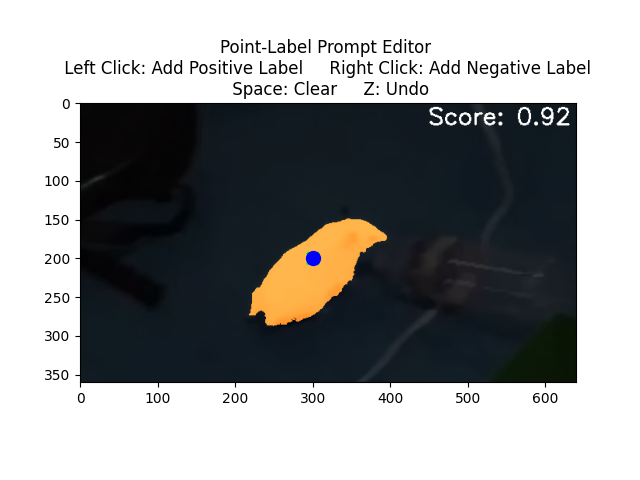

In [ ]:
# @title

import matplotlib.pyplot as plt
import cv2
import os
import sieve

def edit_prompt_interactive(file_path, is_video=True, render_segmenation_maps=True, prompt=None):
    if prompt is None:
        prompt = [{
            "points": [],
            "labels": [],
            "frame_index": 0,
            "object_id": 0,
        }]

    # load video frame
    if is_video:
        video = cv2.VideoCapture(file_path)
        video.set(cv2.CAP_PROP_POS_FRAMES, prompt[0]["frame_index"])
        ret, original_img = video.read()
        if ret == False and original_img is None:
            # try re-encode
            print(f"Couldn't read, re-encoding video...")
            os.system(f"ffmpeg -i {file_path} -c:v libx264 -preset veryfast -crf 23 -y /tmp/re_encoded.mp4")
            file_path = "/tmp/re_encoded.mp4"

            video.release()
            video = cv2.VideoCapture(file_path)
            video.set(cv2.CAP_PROP_POS_FRAMES, prompt[0]["frame_index"])
            ret, original_img = video.read()
            if ret == False and original_img is None:
                raise ValueError("Failed to read video.")
    else:
        original_img = cv2.imread(file_path, cv2.COLOR_BGR2RGB)

    fig, ax = plt.subplots()
    cv2.imwrite("tmp.jpeg", original_img)
    sam2_fn = sieve.function.get("sieve/sam2")
    def update_seg():
        if render_segmenation_maps:
            _, output = sam2_fn.run(sieve.File(path="tmp.jpeg"), prompts=prompt, model_type="tiny", debug_masks=True, multimask_output=False)
            debug_mask = output["debug_mask_0"]
            img = cv2.imread(debug_mask.path, cv2.COLOR_BGR2RGB)
        else:
            img = original_img
        ax.imshow(img)
        ax.set_title("Point-Label Prompt Editor \n Left Click: Add Positive Label     Right Click: Add Negative Label \n Space: Clear     Z: Undo")
        for point, label in zip(prompt[0]["points"], prompt[0]["labels"]):
            ax.plot(point[0], point[1], 'bo' if label == 1 else 'ro', markersize=10)

    def reset():
        ax.clear()
        update_seg()
        fig.canvas.draw()

    reset()

    def onclick(event):
        ix, iy = event.xdata, event.ydata
        prompt[0]["points"].append([ix, iy])
        if event.button == 1:
            color = 'bo'
            prompt[0]["labels"].append(1)
        elif event.button == 3:
            color = 'ro'
            prompt[0]["labels"].append(0)
        else:
            return
        print(f"Prompt: {prompt}")
        update_seg()
        fig.canvas.draw()


    def onspace(event):
        if event.key == ' ':
            prompt[0]["points"] = []
            prompt[0]["labels"] = []
            print(f"Prompt: {prompt}")
            reset()
        if event.key == 'z':
            if prompt[0]["points"]:
                prompt[0]["points"].pop()
                prompt[0]["labels"].pop()
            print(f"Prompt: {prompt}")
            reset()

    fig.canvas.mpl_connect('button_press_event', onclick)
    fig.canvas.mpl_connect('key_press_event', onspace)
    return fig, prompt

import matplotlib
%matplotlib ipympl

# this prompt object will reflect changes made in the interactive window!


_, prompts = edit_prompt_interactive(video_file.path, prompt=prompts, render_segmenation_maps=True);

_Now you can generate some outputs with your prompt!_

In [ ]:
debug_video, outputs = sam2.run(
    file=video_file, prompts=prompts, model_type="tiny",
    preview=False, debug_masks=True, bbox_tracking=True, pixel_confidences=True
)
os.system(f"mv {debug_video.path} ./hamster_custom_output.mp4")
moviepy.editor.ipython_display("./hamster_custom_output.mp4")

<SIEVE_INTERNAL> sieve struct sieve.File(url='https://storage.googleapis.com/sieve-prod-us-central1-public-file-upload-bucket/c4811140-5f42-42e4-b612-1815effc2cfc/14aa4d0e-bb4c-42a3-a6c8-ea1f7ba56ea9-output-d966ffbf-d6b8-4ac3-9384-d7a49e90b4c1.mp4', path='/tmp/tmpahlkx37e14aa4d0e-bb4c-42a3-a6c8-ea1f7ba56ea9-output-d966ffbf-d6b8-4ac3-9384-d7a49e90b4c1.mp4') already has attribute _internal, not creating </SIEVE_INTERNAL>


FPS: 30.0

Extracted frames from video

Initializing model state...

Model state initialized.

Loading prompts...

Prompts loaded.

Propogating masks to video.

Number of frames in video: 489

### Model Types

SAM 2 provides a few different model types. You can see the relatives speeds of each of the model types [here](https://github.com/facebookresearch/segment-anything-2?tab=readme-ov-file#model-description).

We host the `tiny` and `large` models on Sieve. The `tiny` model is faster, while the `large` model is more accurate. You can choose which model to use by setting the `model_type` parameter to `"tiny"` or `"large"`.

### Segmentation Output

The primary output of SAM 2 is segmentation masks for each frame object pair. We return these as a zip of .png files, one for each frame-object id pair.

The filenames are of the form `{frame_index}_{object_id}.png`.

Segmentation masks are returned by default.

Each output item is a sieve.File object stored in the `outputs` dictionary. The segmentation masks can be acccessed with `outputs["masks"]`.

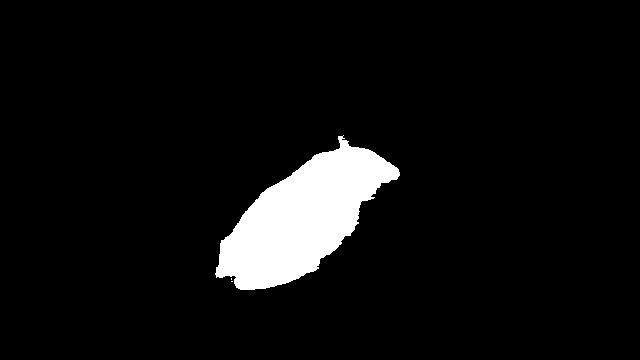

In [ ]:
masks_zip = outputs["masks"]

import zipfile

with zipfile.ZipFile(masks_zip.path, 'r') as zip_ref:
    # Extract a specific file
    zip_ref.extract('mask_0_1.png', ".")

from IPython.display import Image
Image("mask_0_1.png")

### Bounding Box Tracking

Setting `bbox_tracking=True` will track the bounding boxes for objects across each frame. This can be useful for object tracking use cases!

If an object is not present in a frame, it will not have a bounding box included for that frame. The bounding box format is [x_min, y_min, x_max, y_max].

The output maps a frame index to a list of bounding boxes for that frame.

In [ ]:
bboxes = outputs["bbox_tracking"]

import json
with open(bboxes.path, "r") as f:
    bboxes_json = json.load(f)

bboxes_json["0"], bboxes_json["50"]


([{'object_id': 1, 'frame_index': 0, 'bbox': [215, 135, 399, 289]}],
 [{'object_id': 1, 'frame_index': 50, 'bbox': [218, 178, 314, 344]}])

### Pixel Confidences

Setting `pixel_confidences=True` will return a zip file with confidence masks for each frame-object pair. The confidences scores will be given as values in the range 0-255, which correspond to the model confidence score for a given pixel from 0.0 to 1.0.

The output format is the same as the segmentation masks: `{frame_index}_{object_id}.png`.


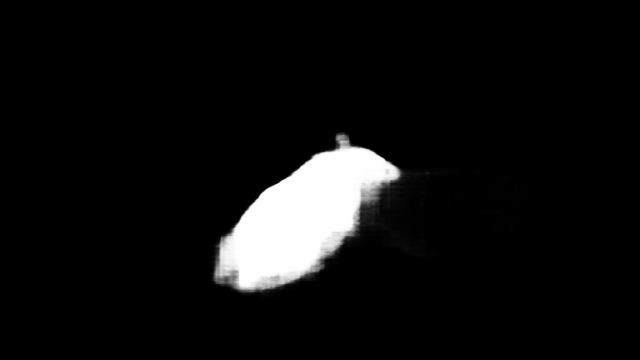

In [ ]:
masks_zip = outputs["confidences"]

import zipfile

with zipfile.ZipFile(masks_zip.path, 'r') as zip_ref:
    # Extract a specific file
    zip_ref.extract('confidences_0_1.png', ".")

from IPython.display import Image
Image("confidences_0_1.png")

### Debug Video

When set to true, returns the original video with segmentation masks overlaid. This is returned as a seperate object, so the output format becomes (`debug_video`, `outputs`).


In [ ]:
os.system(f"mv {debug_video.path} ./hamster_debug_output.mp4")
moviepy.editor.ipython_display("./hamster_debug_output.mp4")

### Trimming

If you'd like to only perform segmenation of a subsequence of the video frames, you can control which frames to segment with the `start_frame` and `end_frame` parameters.

For example, to segment the first 10 frames of a video, you can set `start_frame=0` and `end_frame=10`.

If `end_frame` is set to 0, SAM 2 will segment all frames from `start_frame` to the end of the video.

In [ ]:
debug_video, outputs = sam2.run(
    file=video_file, prompts=prompts, model_type="tiny",
    preview=False, debug_masks=True, bbox_tracking=True, pixel_confidences=True,
    start_frame=0, end_frame=10
)
os.system(f"mv {debug_video.path} ./hamster_debug_output_trimmed.mp4")
moviepy.editor.ipython_display("./hamster_debug_output_trimmed.mp4")

<SIEVE_INTERNAL> sieve struct sieve.File(url='https://sieve-prod-us-central1-local-file-upload-bucket.storage.googleapis.com/0a27f1ed-b241-4a1e-8b3c-e8aff3b8379c/bed39384-7c47-4b4e-ac9f-b34084e29f0c.mp4?X-Goog-Algorithm=GOOG4-RSA-SHA256&X-Goog-Credential=abhi-admin%40sieve-grapefruit.iam.gserviceaccount.com%2F20240826%2Fauto%2Fstorage%2Fgoog4_request&X-Goog-Date=20240826T162016Z&X-Goog-Expires=86400&X-Goog-SignedHeaders=host&x-goog-signature=47fc50ec44188ea5bd5cb8c265d39c62e275897a3947e80c86b2d15fb88e32482f1cc470661751a418d808a58a2df5b155115766e1f4a80085f1f1b7fc6041684e6dd1d49ac4192f4a2f51804f0d1012867afe9c7dd870b1466d4c6a5146b53f7519bb0b347ce1b9ea429c74aadf9d476894cbfe183a3adca1117f7ee68e8147762b14801842f91d97ad7e375f5305608be5e812b164c84889d340e94646e6dd58337ffb47c63d30a49a8e89e910ac96392759a9d176464f280042bcc049172a6ff4440dc5dfebadcd986ce47cb9344f82f78f728c8e4ccc725923fc95196038a5d6d72c15c0ac9f2e1115f085622ed743f7773777aa52775766ca655be32ddd') already has attribute _internal, not cr

### Previewing

The SAM 2 endpoint provides a `preview` option that's useful for visualizing the results on a single frame before running the entire job. Normally, outputs are returned as a dictionary of sieve.File objects, but in the case of previewing the output is returned as a single tuple of sieve.File objects instead (for easier visualization in the UI).

In [ ]:
debug_masks_preview, outputs = sam2.run(
    file=video_file, prompts=prompts, model_type="tiny",
    preview=True, bbox_tracking=True, pixel_confidences=True)

masks_preview = outputs["mask_0_1"]
confs_preview = outputs["confidences_0_1"]
bbox_preview = outputs["bbox_tracking"]

outputs

{'mask_0_1': sieve.File(detail='File stored remotely to save storage. Please use .path to download'),
 'debug_mask_0_1': sieve.File(detail='File stored remotely to save storage. Please use .path to download'),
 'confidences_0_1': sieve.File(detail='File stored remotely to save storage. Please use .path to download'),
 'bbox_tracking': sieve.File(detail='File stored remotely to save storage. Please use .path to download')}

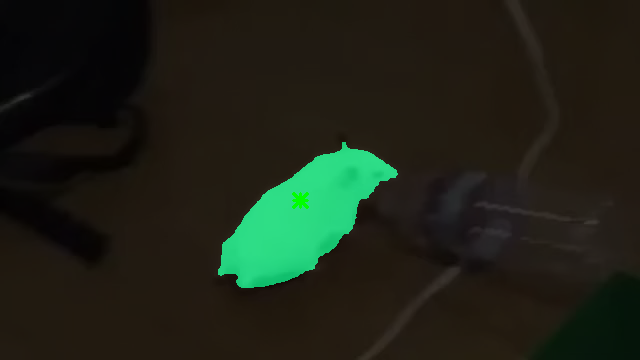

In [ ]:
Image(debug_masks_preview.path)

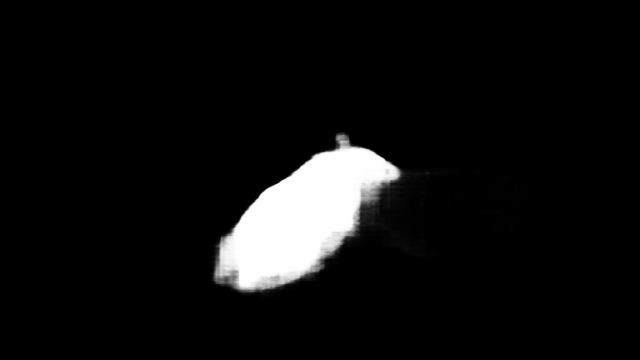

In [ ]:
Image(confs_preview.path)

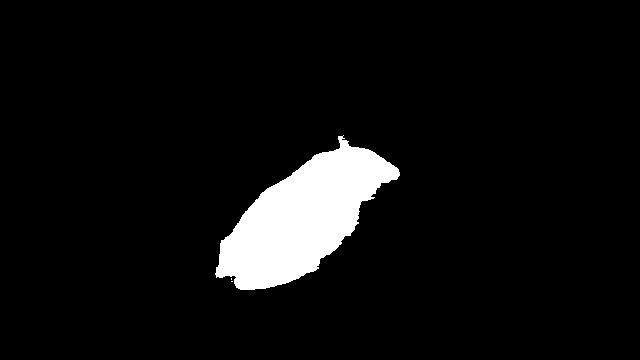

In [ ]:
Image(masks_preview.path)

In [ ]:
import json
json.load(open(bbox_preview.path))

{'0': [{'object_id': 1, 'frame_index': 0, 'bbox': [215, 135, 399, 289]}]}

## Processing Images
SAM 2 is mostly for video use-cases, but it still can be used for image segmentation. With the exception of bounding box tracking and trimming, the same configuration options are available for image segmentation.

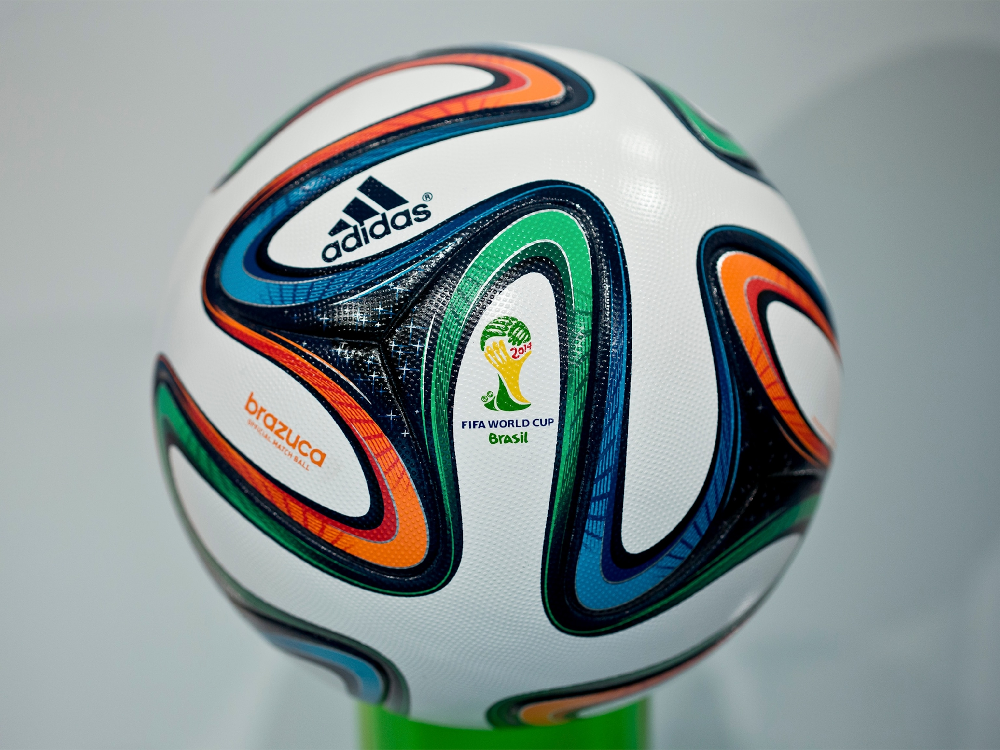

In [ ]:
image_url = "https://i.natgeofe.com/n/672b580d-0597-4e59-b57c-51f149bf92e8/80254.jpg"

image = sieve.File(url=image_url)

Image(image.path, width=400)

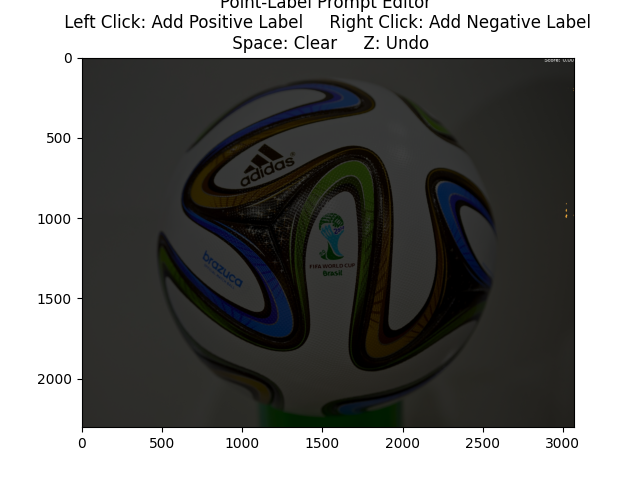

Prompt: [{'points': [[1878.3571428571424, 494.46103896103887]], 'labels': [1], 'frame_index': 0, 'object_id': 0}]


In [ ]:
_, image_prompt = edit_prompt_interactive(image.path, is_video=False, render_segmenation_maps=True)

In [ ]:
_, outputs = sam2.run(
    file=image, prompts=image_prompt, model_type="tiny",
    preview=True, bbox_tracking=True, pixel_confidences=True, debug_masks=True
)
outputs

{'mask_0': sieve.File(detail='File stored remotely to save storage. Please use .path to download'),
 'confidence_0': sieve.File(detail='File stored remotely to save storage. Please use .path to download'),
 'debug_mask_0': sieve.File(detail='File stored remotely to save storage. Please use .path to download')}

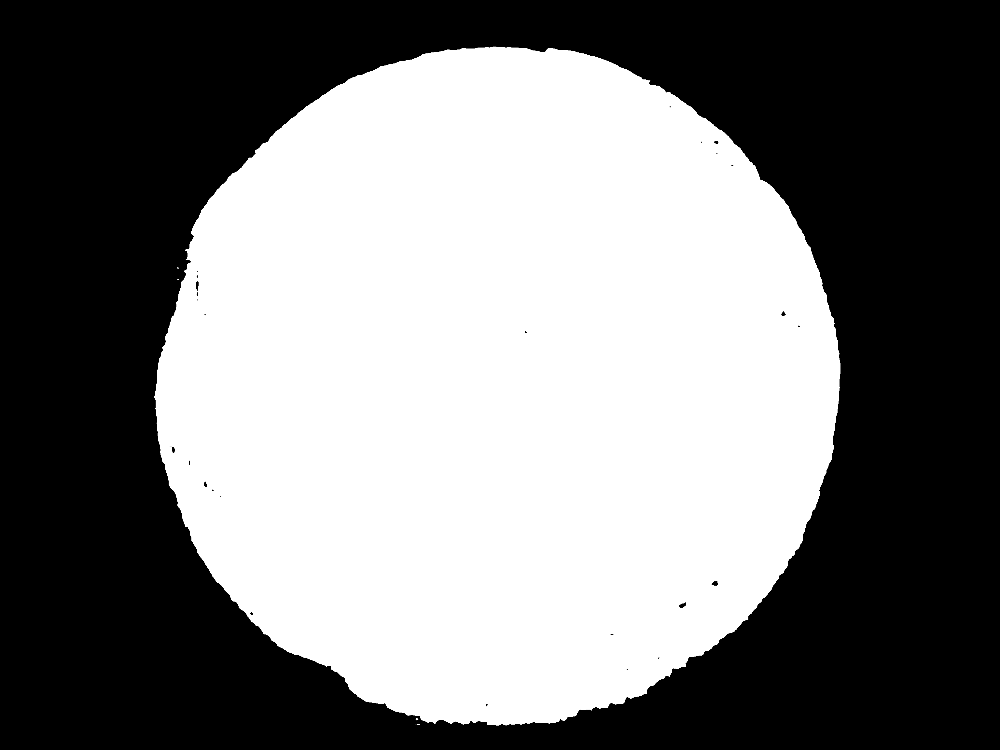

In [ ]:
Image(outputs["mask_0"].path)

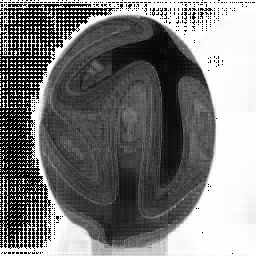

In [ ]:
Image(outputs["confidence_0"].path)

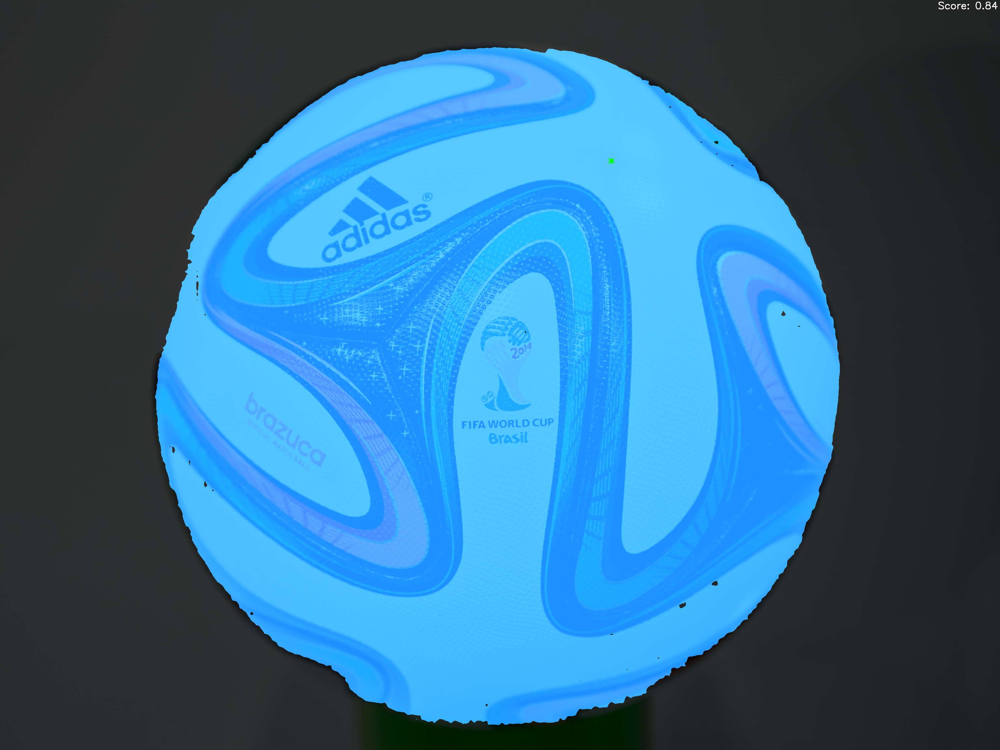

In [ ]:
Image(outputs["debug_mask_0"].path)

### Image Multimask

If true, the model will return three masks. For ambiguous input prompts (such as a single click), this will often produce better masks than a single prediction. If only a single mask is needed, the model's predicted quality score can be used to select the best mask. For non-ambiguous prompts, such as multiple input prompts, `multimask_output=False` can give better results.

In [ ]:
_, outputs = sam2.run(
    file=image, prompts=image_prompt, model_type="tiny",
    preview=True, bbox_tracking=True, pixel_confidences=True, debug_masks=True,
    multimask_output=True
)
outputs

<SIEVE_INTERNAL> sieve struct sieve.File(url='https://sieve-prod-us-central1-local-file-upload-bucket.storage.googleapis.com/0a27f1ed-b241-4a1e-8b3c-e8aff3b8379c/05fb02e5-9a58-4e97-8103-b4867c600a70.jpg?X-Goog-Algorithm=GOOG4-RSA-SHA256&X-Goog-Credential=abhi-admin%40sieve-grapefruit.iam.gserviceaccount.com%2F20240826%2Fauto%2Fstorage%2Fgoog4_request&X-Goog-Date=20240826T162354Z&X-Goog-Expires=86400&X-Goog-SignedHeaders=host&x-goog-signature=07021dc1816490d4652e512be978b1ad5ba4103748d13b13e523c2ded178e155a8293f24bf5956cf9eee90e9d6964f18c2c65fa593174977216fb1010097d662c3e3e4d6b949806fa54bc8c7996a4fb1c3be26a40875f22551f5a3ea37722e84248050f7cac081cd281dc22ef7cca13a20a0c1649de918175ad14d8be6f20cab361d2628329059c5ac866626b3c99e16c8c203c959b7e8e86eef2a6728bfbc089f35b4384b4f41af375a25975cf578707b9f30563aac73e841b6803fcf09e5817ef073758baf854f678cf2d27208dca60d375e79be6d7ba7b975f0ed66d1a491fe75c06f56da478c8348f78e800447c8700029b75ab1317f0db2d200a4a6ac93') already has attribute _internal, not cr

Masks generated successfully.

Predict took 1.0754780769348145 seconds

{'mask_0': sieve.File(detail='File stored remotely to save storage. Please use .path to download'),
 'mask_1': sieve.File(detail='File stored remotely to save storage. Please use .path to download'),
 'mask_2': sieve.File(detail='File stored remotely to save storage. Please use .path to download'),
 'confidence_0': sieve.File(detail='File stored remotely to save storage. Please use .path to download'),
 'confidence_1': sieve.File(detail='File stored remotely to save storage. Please use .path to download'),
 'confidence_2': sieve.File(detail='File stored remotely to save storage. Please use .path to download'),
 'debug_mask_0': sieve.File(detail='File stored remotely to save storage. Please use .path to download'),
 'debug_mask_1': sieve.File(detail='File stored remotely to save storage. Please use .path to download'),
 'debug_mask_2': sieve.File(detail='File stored remotely to save storage. Please use .path to download')}

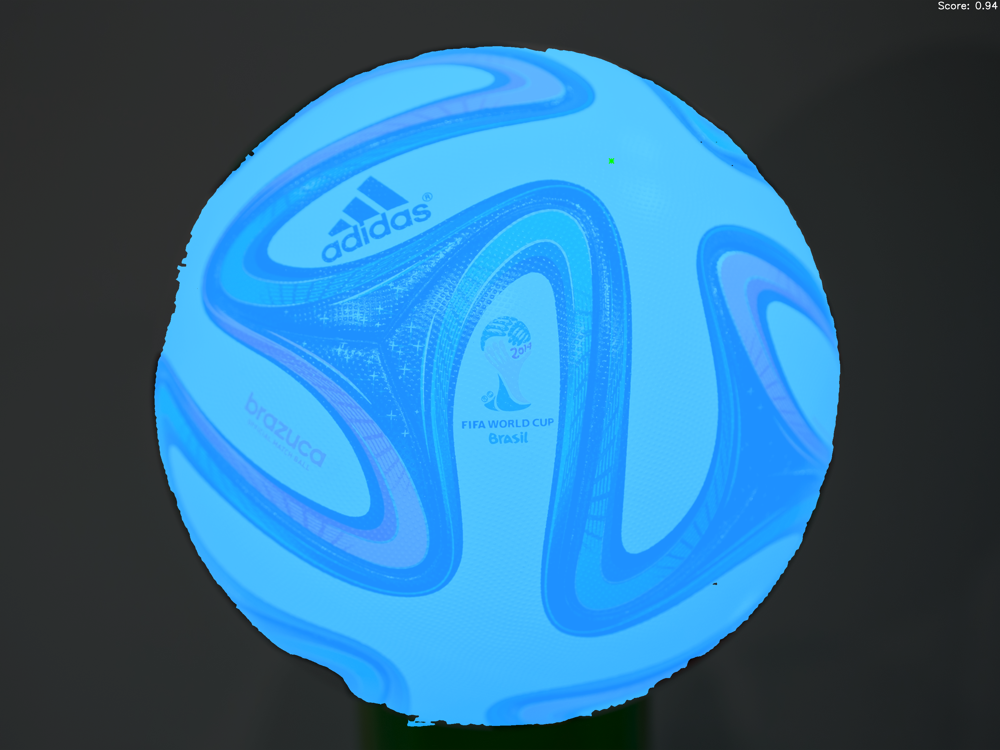

In [ ]:
Image(outputs["debug_mask_0"].path)

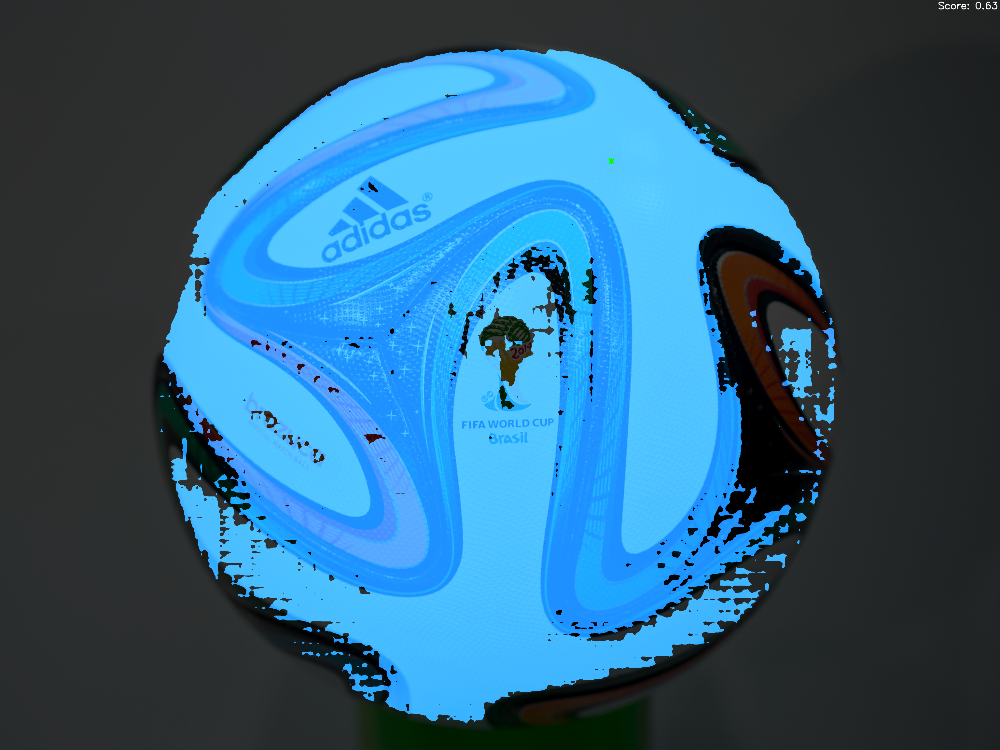

In [ ]:
Image(outputs["debug_mask_1"].path)

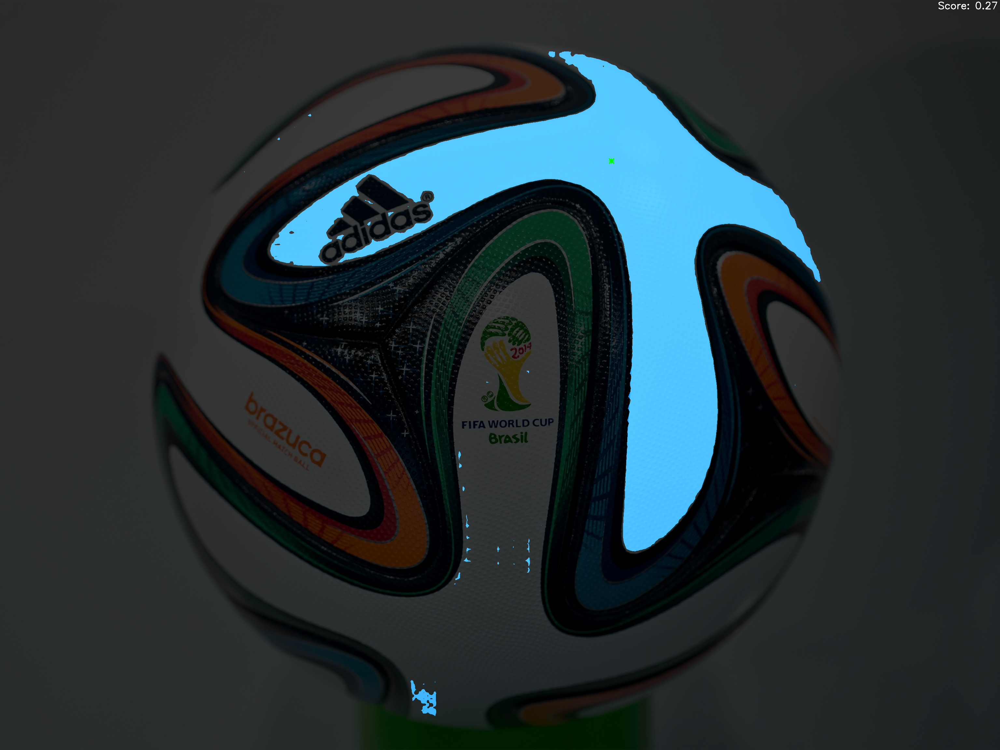

In [ ]:
Image(outputs["debug_mask_2"].path)

We can't wait to see all the cool things you build with Sieve and SAM 2!

Make sure to tag us on X [@sievedata](https://x.com/sievedata) if you build something awesome!

For more on SAM 2, check out the [SAM 2 paper](https://ai.meta.com/research/publications/sam-2-segment-anything-in-images-and-videos/) and the [SAM 2 repo](https://github.com/facebookresearch/segment-anything-2).